In [20]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

In [21]:
img_path = '/export/data/mdorkenw/data/alaska2/'
methods = ['Cover', 'JMiPOD', 'JUNIWARD', 'UERD']

In [30]:
## Select 5 random images for visualization
images = os.listdir(img_path + 'Cover/')
rand = np.random.randint(0, len(images), 10)
rand_img = [images[i] for i in rand]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

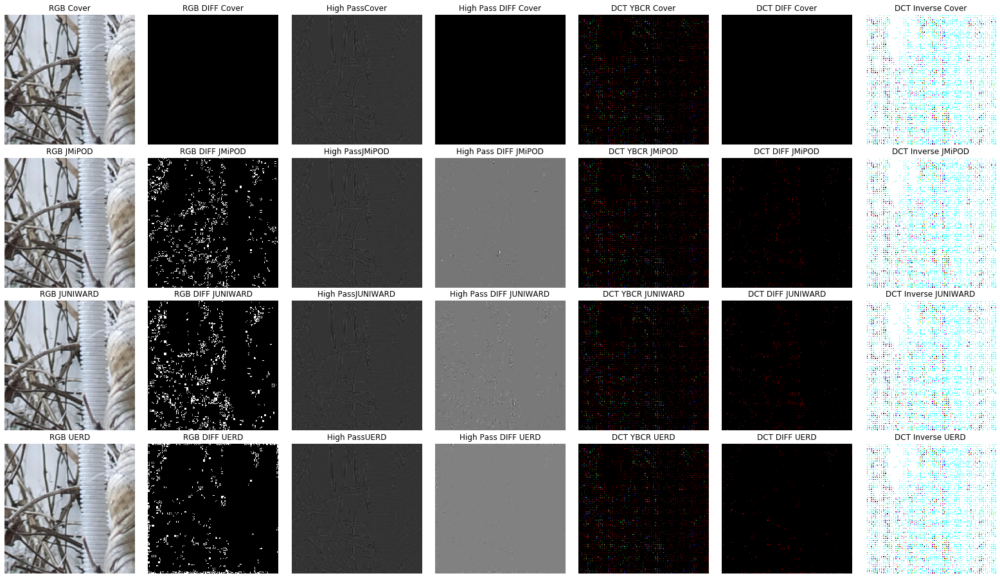

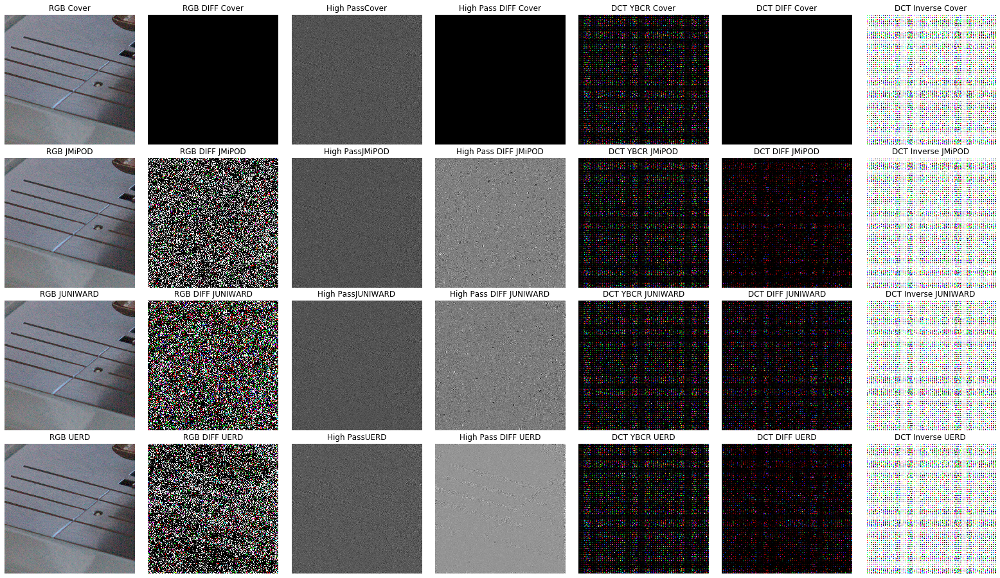

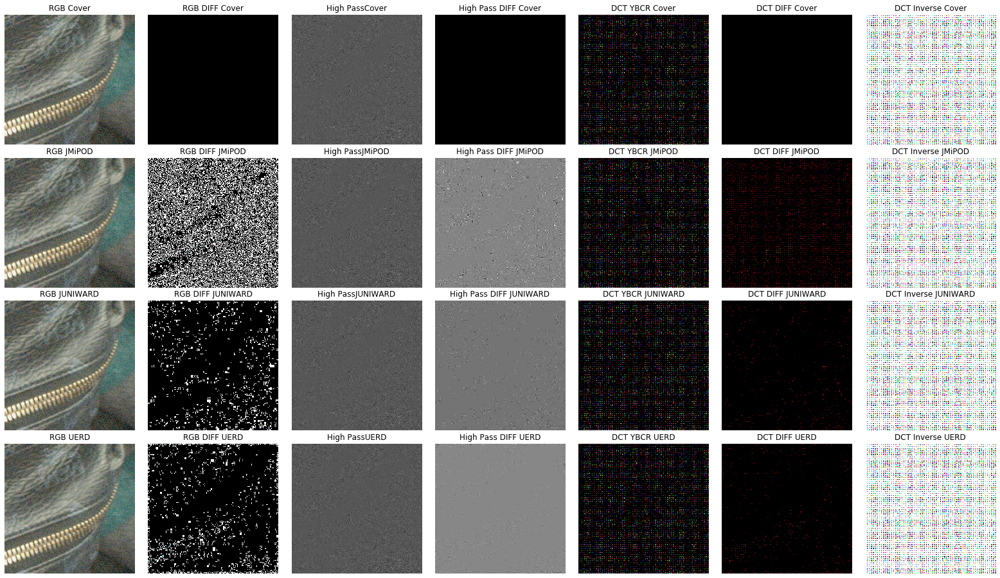

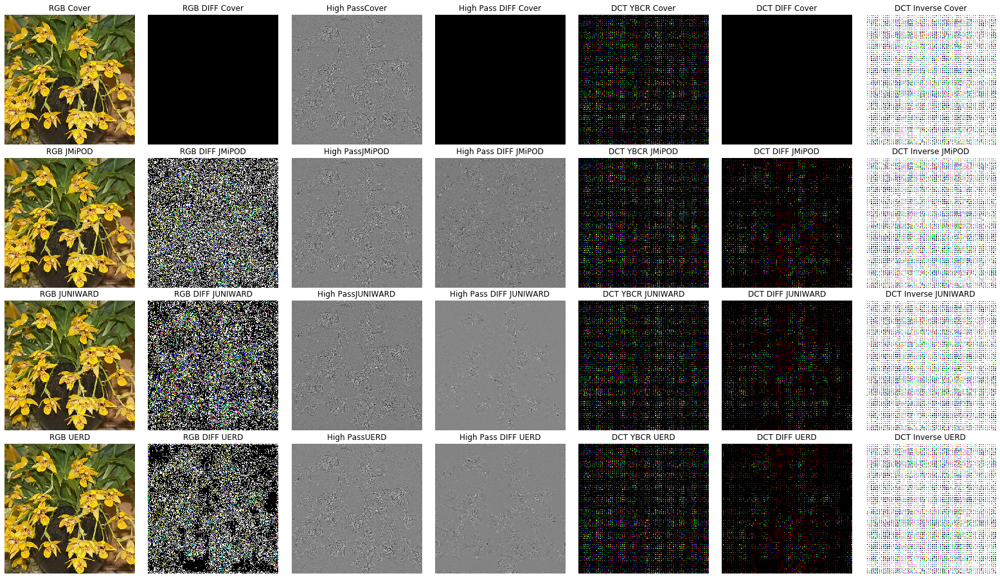

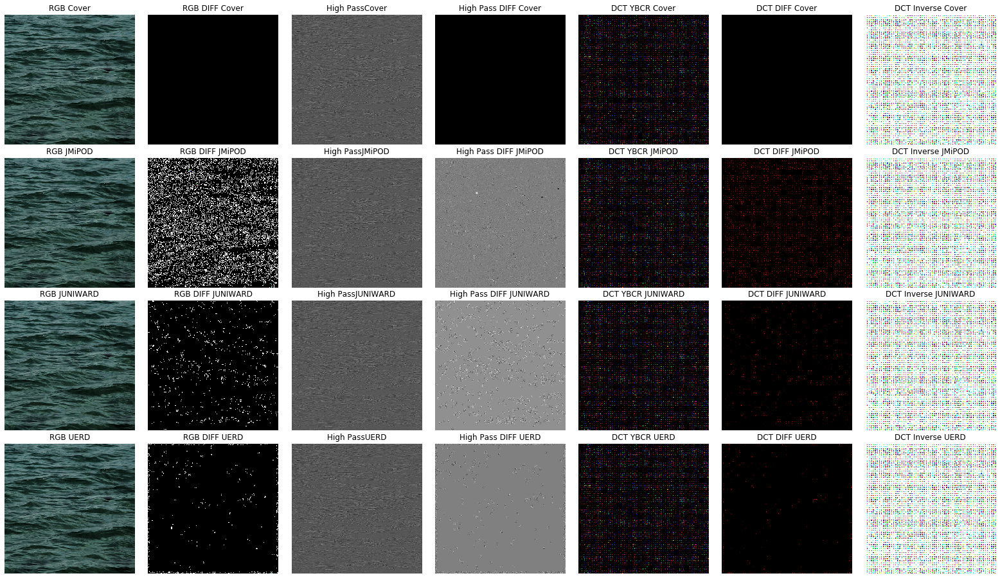

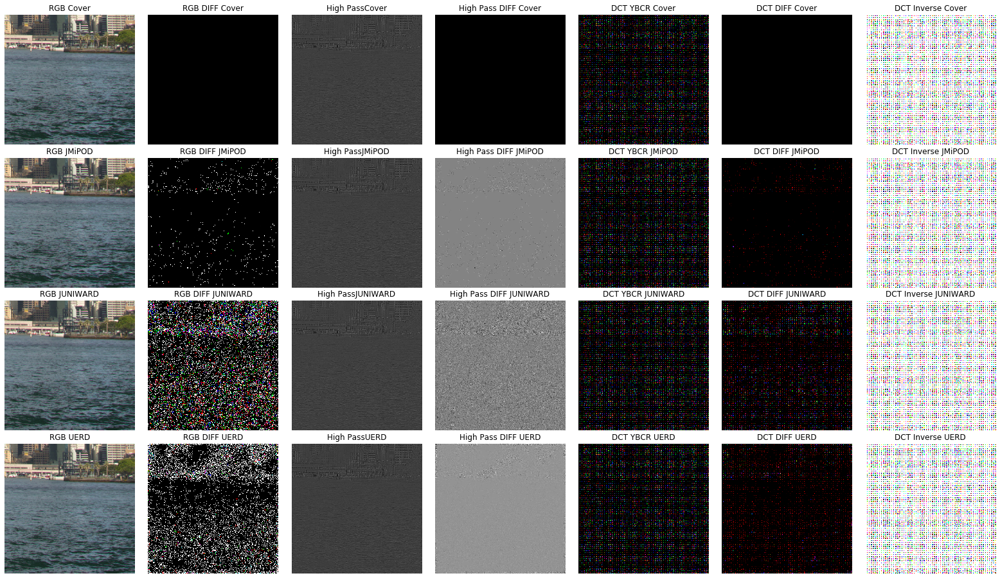

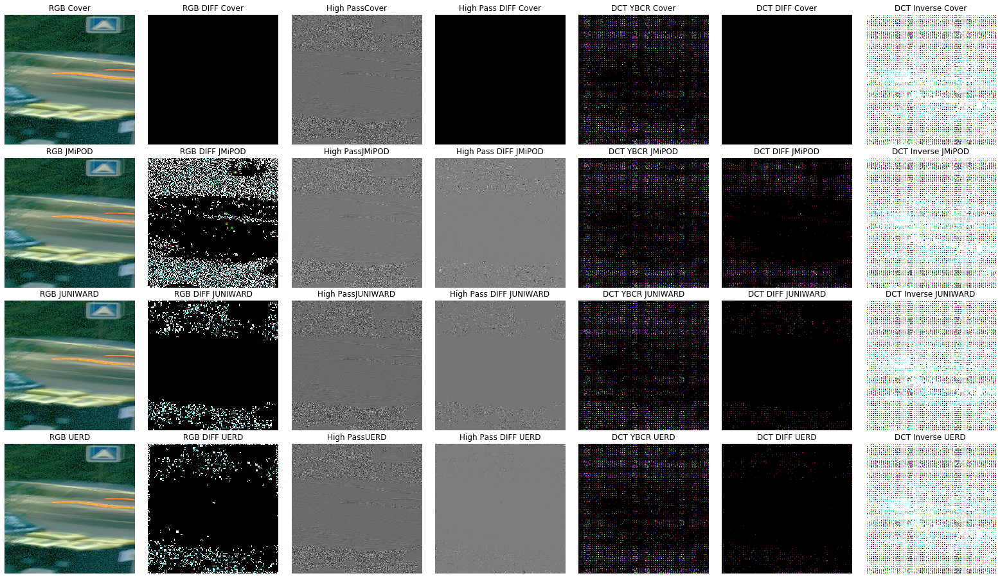

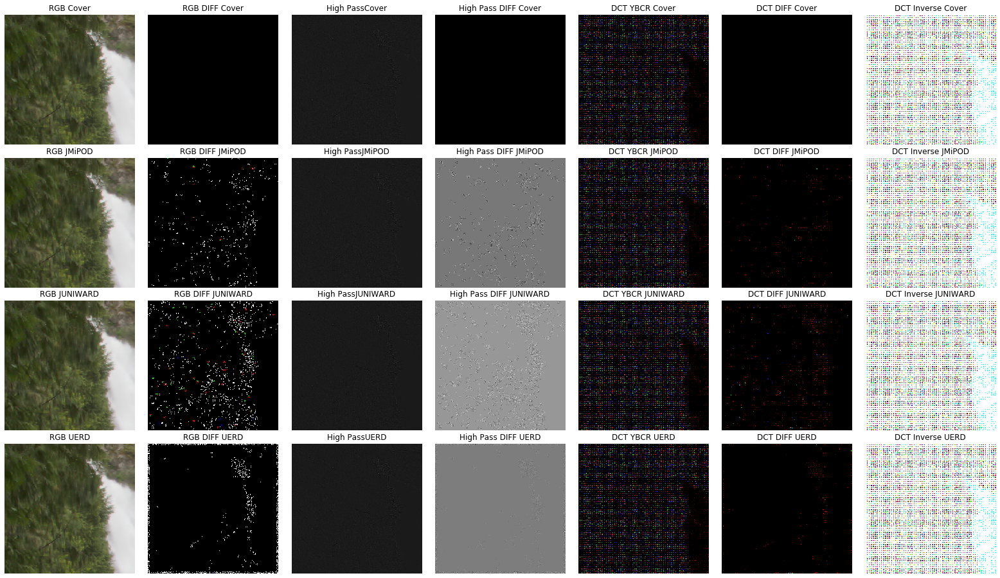

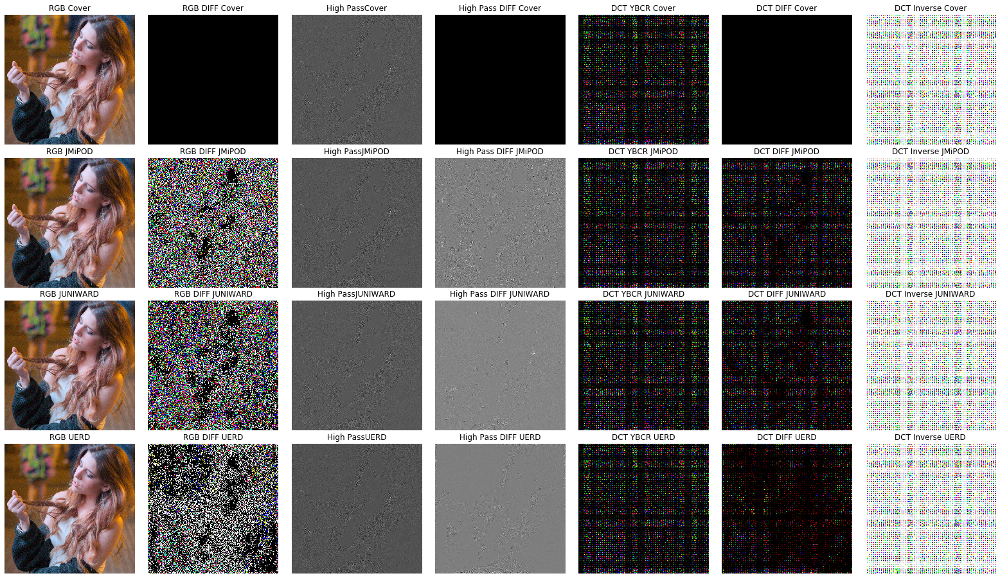

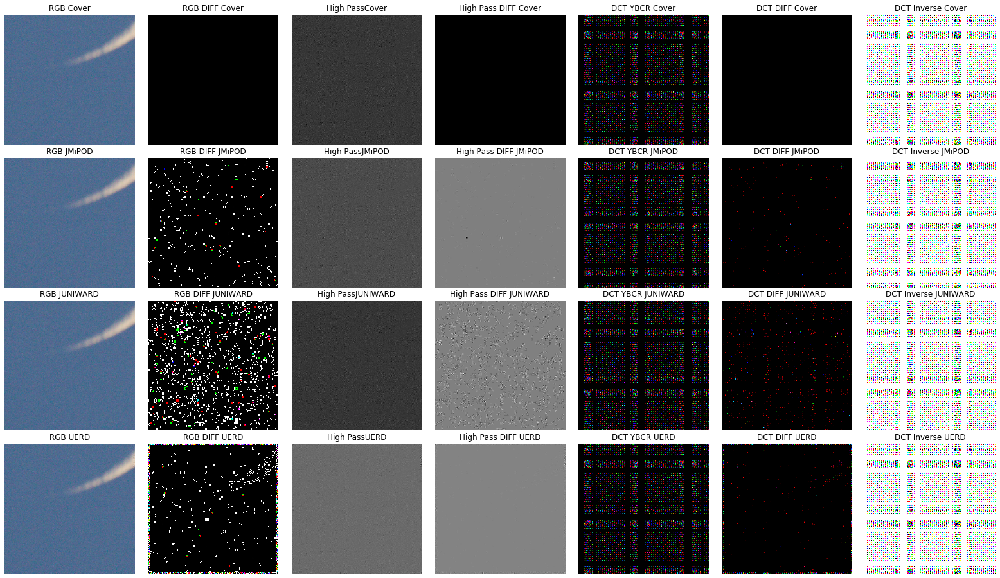

In [32]:
from numpy import r_
from scipy.fftpack import dct

def to_DCT(im):
    def apply_dct(a):
        return dct(dct( a, axis=0, norm='ortho'), axis=1, norm='ortho')
    imsize = im.shape
    dct2 = np.zeros(imsize)

    # Do 8x8 DCT on image (in-place)
    for i in r_[:imsize[0]:8]:
        for j in r_[:imsize[1]:8]:
            dct2[i:(i+8),j:(j+8)] = apply_dct(im[i:(i+8),j:(j+8)])
            dct2[i:(i+8),j:(j+4)] = np.zeros((8,4,3))
            dct2[i:(i+4),j:(j+8)] = np.zeros((4,8,3))
    return dct2

import torch
from torchvision import transforms

high_pass_filter = torch.nn.Conv2d(1, 1, 3, 1, 1, bias=False)
kernel = torch.from_numpy(np.array([[0, -1 / 4, 0], [-1 / 4, 1, -1 / 4], [0, -1 / 4, 0]]))
high_pass_filter.weight = torch.nn.Parameter(kernel.unsqueeze(0).unsqueeze(0).float())

jo = 5
for jo in range(10):
    fig, axs = plt.subplots(4, 7, figsize=(28,16))
    fig.subplots_adjust(hspace = 0.1, wspace=.001)

    methods = ['Cover', 'JMiPOD', 'JUNIWARD', 'UERD']

    images = [Image.open(img_path + met + '/' + rand_img[jo]) for met in methods]

    for i in range(4):
        for j in range(7):
            image = images[i]
            if j == 0:
                axs[i, j].imshow(image)
                axs[i, j].set_title('RGB ' + methods[i])
                axs[i, j].axis('off')
            if j == 1:
                axs[i, j].imshow(np.array(images[0])-np.array(image))
                axs[i, j].set_title('RGB DIFF ' + methods[i])
                axs[i, j].axis('off')
            if j == 2:
                image = high_pass_filter(transforms.ToTensor()(image.convert('L')).unsqueeze(0)).squeeze().detach().numpy()
                axs[i, j].imshow(image, cmap = 'gray')
                axs[i, j].set_title('High Pass' + methods[i])
                axs[i, j].axis('off')
            if j ==3:
                image1 = high_pass_filter(transforms.ToTensor()(image.convert('L')).unsqueeze(0)).squeeze().detach().numpy()
                image2 = high_pass_filter(transforms.ToTensor()(images[0].convert('L')).unsqueeze(0)).squeeze().detach().numpy()
                axs[i, j].imshow(image2-image1, cmap = 'gray')
                axs[i, j].set_title('High Pass DIFF ' + methods[i])
                axs[i, j].axis('off')
            if j == 4:
                image = np.array(image.convert('YCbCr'))
                axs[i, j].imshow(to_DCT(image).astype(float), cmap='gray', vmax = np.max(image)*0.01, vmin = 0)
                axs[i, j].axis('off')
                axs[i, j].set_title('DCT YBCR ' + methods[i])
            if j == 5:
                image = to_DCT(np.array(images[0].convert('YCbCr')))- to_DCT(np.array(image.convert('YCbCr')))
                axs[i, j].imshow(image.astype(float), cmap='gray', vmax = np.max(image)*0.01, vmin = 0)
                axs[i, j].axis('off')
                axs[i, j].set_title('DCT DIFF ' + methods[i])
            if j == 6:
                image = np.array(image.convert('YCbCr'))
#                 image = np.abs(image)/image.max()
                axs[i, j].imshow(1/(to_DCT(image)+1e-3).astype(float), cmap='gray')
                axs[i, j].axis('off')
                axs[i, j].set_title('DCT Inverse ' + methods[i])
                
#             if j == 5:
#                 image = np.array(image)
#                 axs[i, j].imshow(to_DCT(image).astype(float), cmap='gray', vmax = np.max(image)*0.01, vmin = 0)
#                 axs[i, j].axis('off')
#                 axs[i, j].set_title('DCT RGB' + methods[i])
#             if j == 6:
#                 image = to_DCT(np.array(images[0]))- to_DCT(np.array(image))
#                 axs[i, j].imshow(image.astype(float), cmap='gray', vmax = np.max(image)*0.01, vmin = 0)
#                 axs[i, j].axis('off')
#                 axs[i, j].set_title('DCT DIFF RGB' + methods[i])
                
    plt.savefig('visualization' + str(jo) + '.png', dpi=100)

In [ ]:
jop = np.abs(np.tanh(to_DCT(image)))
plt.hist(jop.flatten())

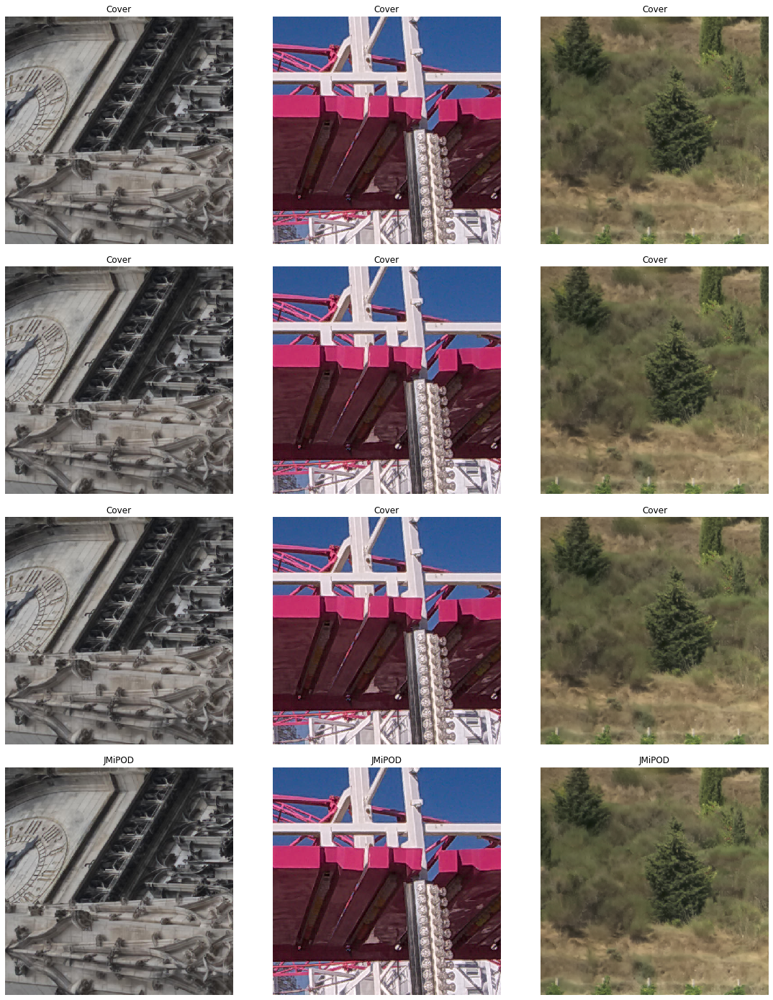

In [82]:
fig, axs = plt.subplots(4,3, figsize=(20,25))
fig.subplots_adjust(hspace = 0.1, wspace=.001)

for i in range(4):
    for j in range(3):
        image = Image.open(img_path + methods[i] + '/' + rand_img[j])
        axs[i, j].imshow(image)
        axs[i, j].set_title( methods[i//3])
        axs[i, j].axis('off')

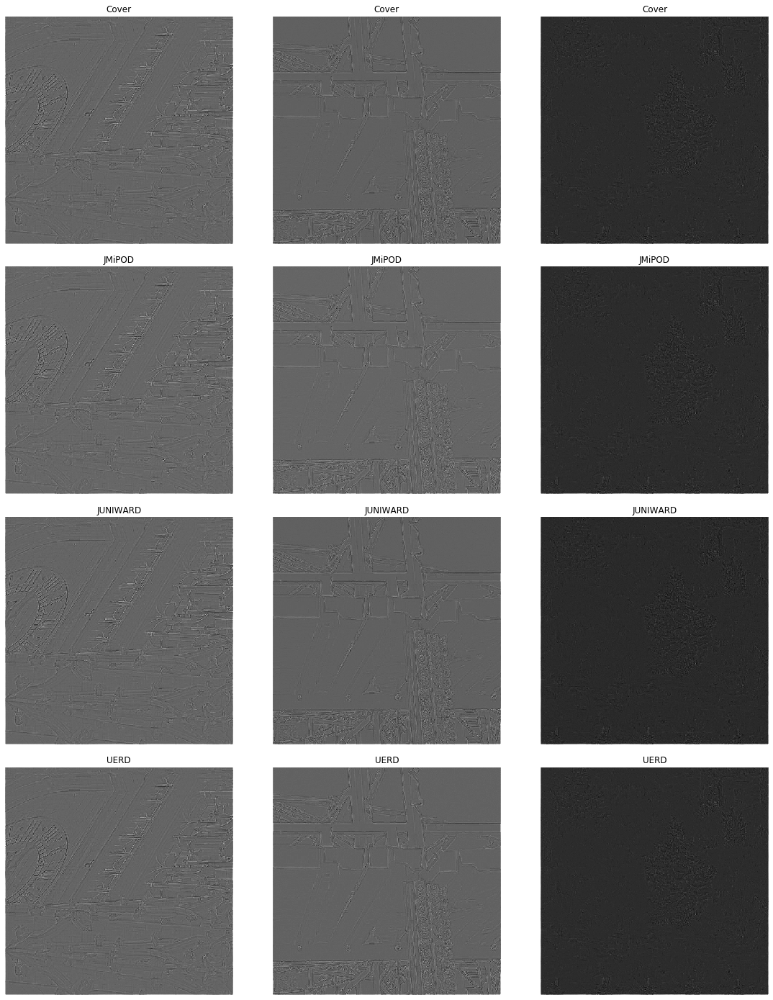

In [34]:
import torch
from torchvision import transforms

high_pass_filter = torch.nn.Conv2d(1, 1, 3, 1, 1, bias=False)
kernel = torch.from_numpy(np.array([[0, -1 / 4, 0], [-1 / 4, 1, -1 / 4], [0, -1 / 4, 0]]))
high_pass_filter.weight = torch.nn.Parameter(kernel.unsqueeze(0).unsqueeze(0).float())

fig, axs = plt.subplots(4,3, figsize=(20,25))
fig.subplots_adjust(hspace = 0.1, wspace=.001)
axs = axs.ravel()

for i in range(12):
    im = Image.open(img_path + methods[i//3] + '/' + rand_img[i%3]).convert('L')
    image = high_pass_filter(transforms.ToTensor()(im).unsqueeze(0)).squeeze().detach().numpy()
    axs[i].imshow(image*10, cmap='gray')
    axs[i].set_title( methods[i//3])
    axs[i].axis('off')

(tensor(0.4246), tensor(0.8094))

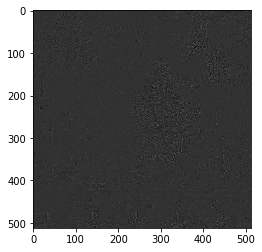

In [65]:
mask = torch.from_numpy(image).unsqueeze(0)*5
plt.imshow(mask.squeeze().numpy(), cmap='gray')
# mask_pool = torch.nn.MaxPool2d(5)(mask)
# plt.imshow(mask_pool.squeeze().numpy(), cmap='gray')
mask_pool = torch.nn.Sigmoid()(mask)
plt.imshow(mask_pool.squeeze().numpy(), cmap='gray')
mask_pool.min(), mask_pool.max()

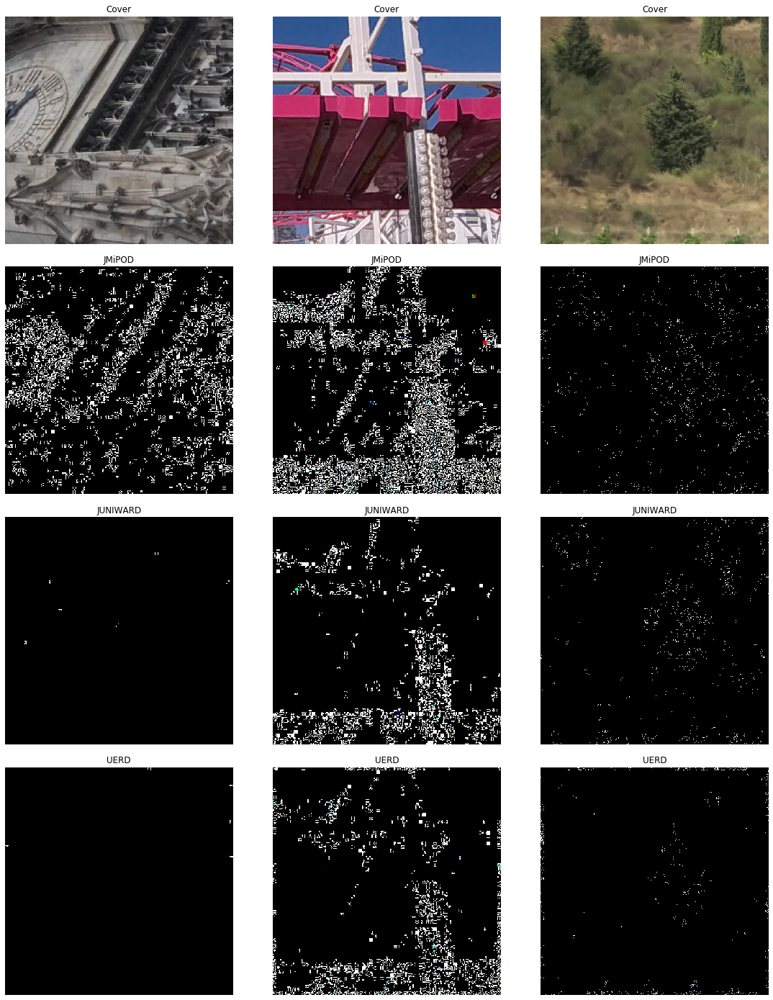

In [14]:
fig, axs = plt.subplots(4,3, figsize=(20,25))
fig.subplots_adjust(hspace = 0.1, wspace=.001)
axs = axs.ravel()

for i in range(12):
    image = np.array(Image.open(img_path + methods[i//3] + '/' + rand_img[i%3]))
    if i >=3:
        image = np.array(Image.open(img_path + methods[0] + '/' + rand_img[i%3])) - image
    axs[i].imshow(image)
    axs[i].set_title( methods[i//3])
    axs[i].axis('off')

In [15]:
from numpy import r_
from scipy.fftpack import dct

def to_DCT(im):
    def apply_dct(a):
        return dct(dct( a, axis=0, norm='ortho'), axis=1, norm='ortho')
    imsize = im.shape
    dct2 = np.zeros(imsize)

    # Do 8x8 DCT on image (in-place)
    for i in r_[:imsize[0]:8]:
        for j in r_[:imsize[1]:8]:
            dct2[i:(i+8),j:(j+8)] = apply_dct(im[i:(i+8),j:(j+8)] )
    return dct2

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

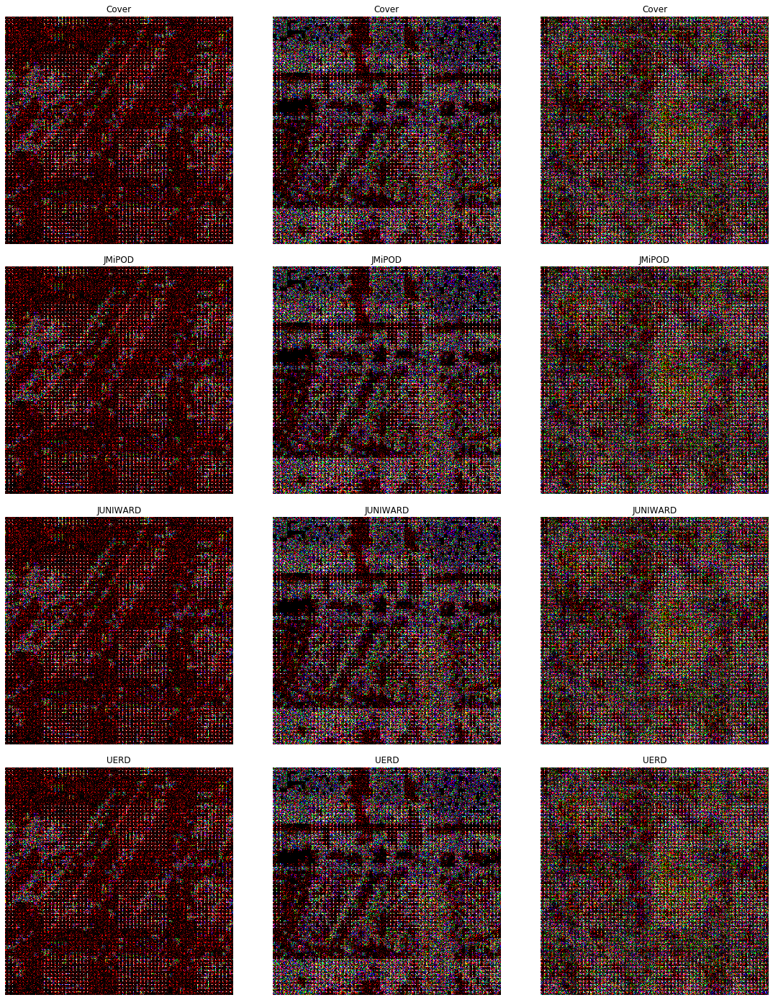

In [16]:
fig, axs = plt.subplots(4,3, figsize=(20,25))
fig.subplots_adjust(hspace = 0.1, wspace=.001)
axs = axs.ravel()

for i in range(12):
    image = np.array(Image.open(img_path + methods[i//3] + '/' + rand_img[i%3]).convert('YCbCr'))
    axs[i].imshow(to_DCT(image), cmap='gray', vmax = np.max(image)*0.01, vmin = 0)
    axs[i].set_title( methods[i//3])
    axs[i].axis('off')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

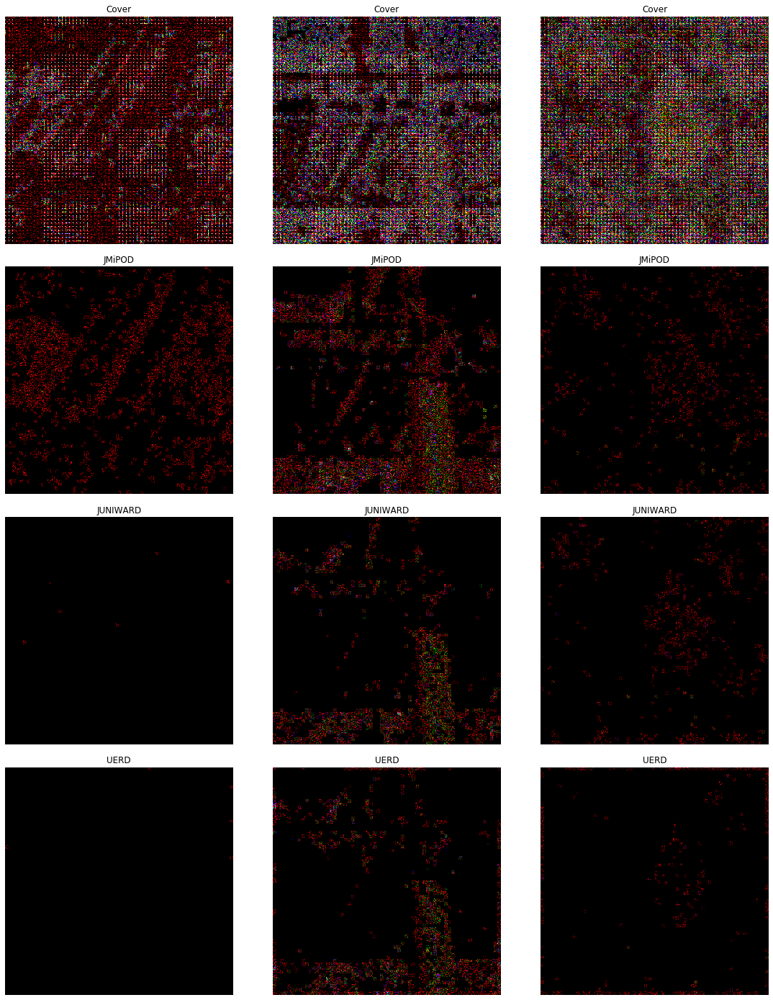

In [19]:
fig, axs = plt.subplots(4,3, figsize=(20,25))
fig.subplots_adjust(hspace = 0.1, wspace=.001)
axs = axs.ravel()

for i in range(12):
    image = to_DCT(np.array(Image.open(img_path + methods[i//3] + '/' + rand_img[i%3]).convert('YCbCr')))
    if i >=3:
        image =  to_DCT(np.array(Image.open(img_path + methods[0] + '/' + rand_img[i%3]).convert('YCbCr'))) - image
    axs[i].imshow(image, cmap='gray', vmax = np.max(image)*0.01, vmin = 0)
    axs[i].set_title( methods[i//3])
    axs[i].axis('off')

## Visualize DCT coeff

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

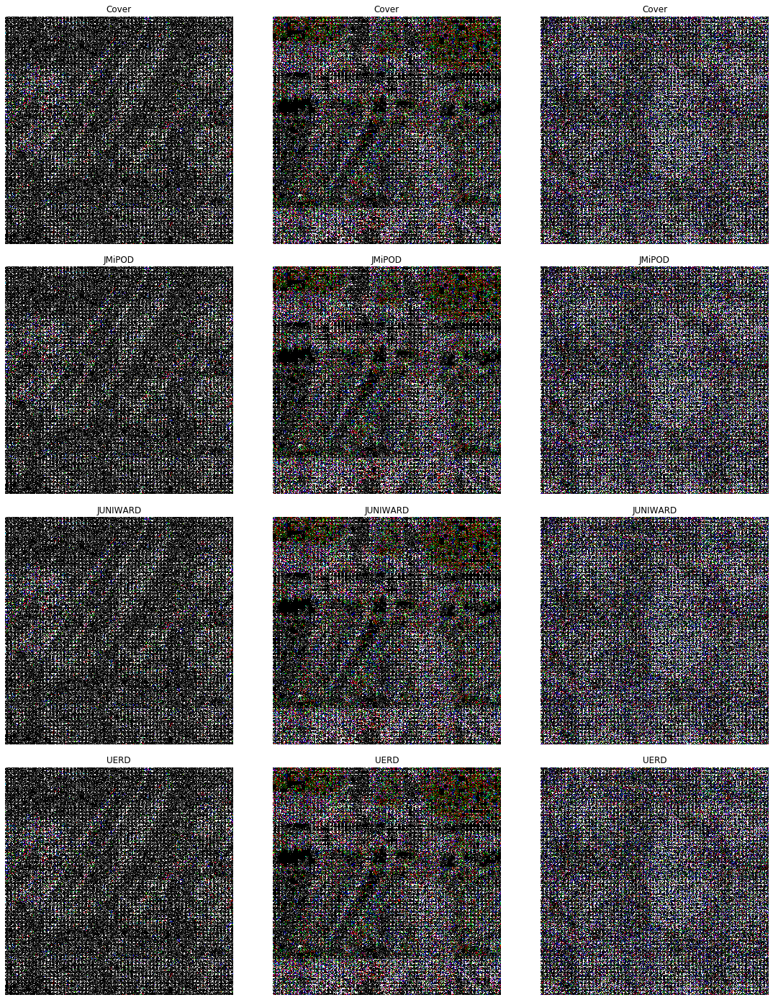

In [20]:
fig, axs = plt.subplots(4,3, figsize=(20,25))
fig.subplots_adjust(hspace = 0.1, wspace=.001)
axs = axs.ravel()

for i in range(12):
    image = np.array(Image.open(img_path + methods[i//3] + '/' + rand_img[i%3]))
    axs[i].imshow(to_DCT(image), cmap='gray', vmax = np.max(image)*0.01, vmin = 0)
    axs[i].set_title( methods[i//3])
    axs[i].axis('off')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

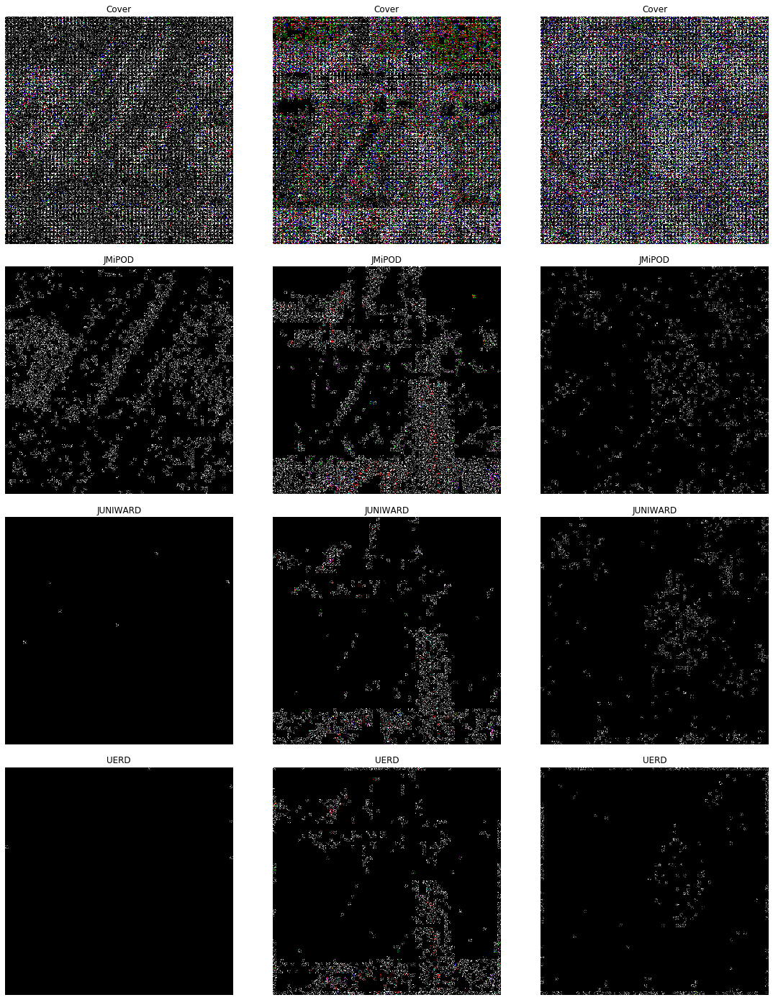

In [21]:
fig, axs = plt.subplots(4,3, figsize=(20,25))
fig.subplots_adjust(hspace = 0.1, wspace=.001)
axs = axs.ravel()

for i in range(12):
    image = to_DCT(np.array(Image.open(img_path + methods[i//3] + '/' + rand_img[i%3])))
    if i >=3:
        image =  to_DCT(np.array(Image.open(img_path + methods[0] + '/' + rand_img[i%3]))) - image
    axs[i].imshow(image, cmap='gray', vmax = np.max(image)*0.01, vmin = 0)
    axs[i].set_title( methods[i//3])
    axs[i].axis('off')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

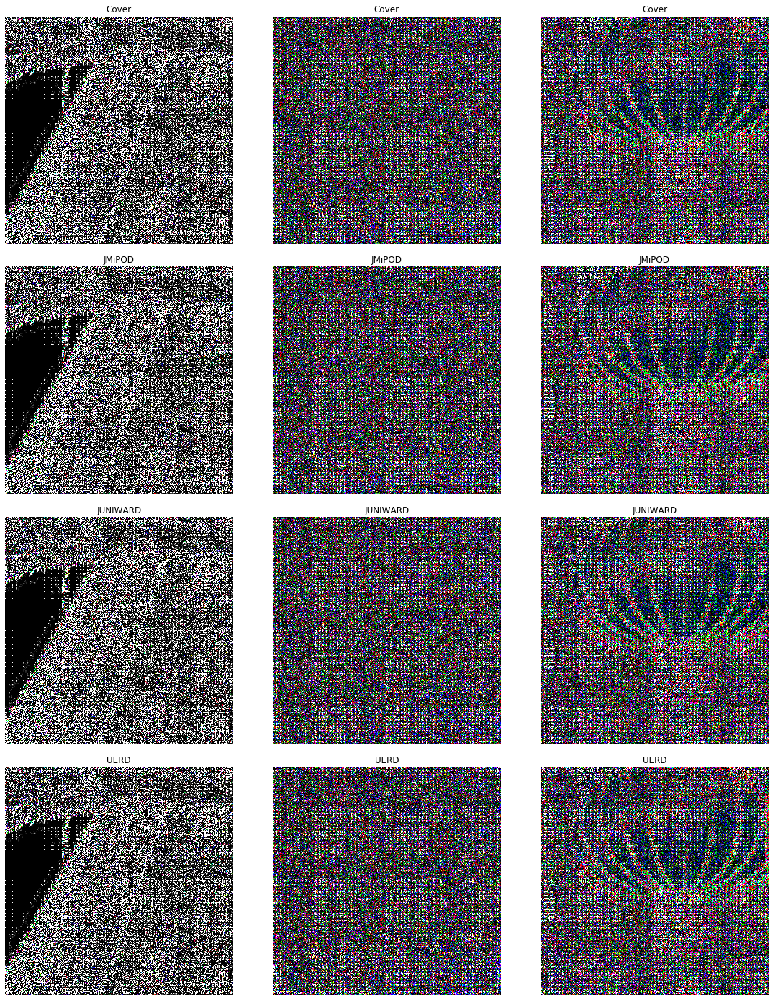

In [66]:
fig, axs = plt.subplots(4,3, figsize=(20,25))
fig.subplots_adjust(hspace = 0.1, wspace=.001)
axs = axs.ravel()

for i in range(12):
    image = np.load(img_path + 'DCT/' + methods[i//3] + '/' + rand_img[i%3][:-4] + '_block.npy')
    axs[i].imshow(image, cmap='gray', vmax = np.max(image)*0.01, vmin = 0)
    axs[i].set_title( methods[i//3])
    axs[i].axis('off')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

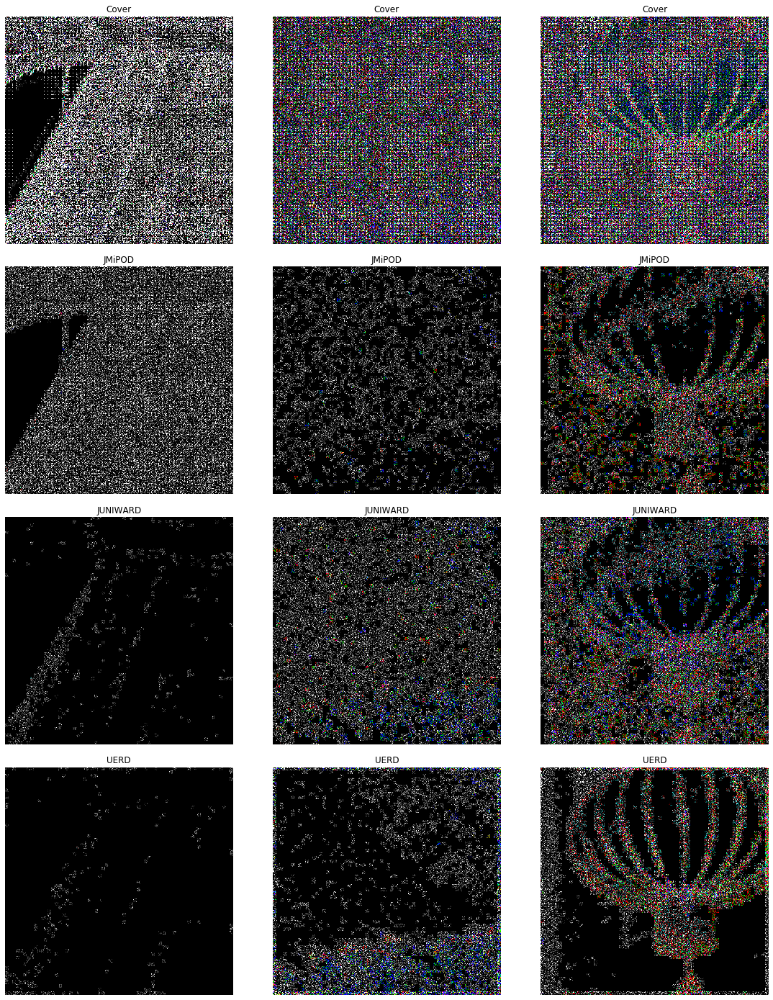

In [67]:
fig, axs = plt.subplots(4,3, figsize=(20,25))
fig.subplots_adjust(hspace = 0.1, wspace=.001)
axs = axs.ravel()

for i in range(12):
    image = np.load(img_path + 'DCT/' + methods[i//3] + '/' + rand_img[i%3][:-4] + '_block.npy')
    if i >=3:
        image = np.load(img_path + 'DCT/' + methods[0] + '/' + rand_img[i%3][:-4] + '_block.npy') - image
    axs[i].imshow(image, cmap='gray', vmax = np.max(image)*0.01, vmin = 0)
    axs[i].set_title( methods[i//3])
    axs[i].axis('off')

In [74]:
for i,name in enumerate(images):
    if name == rand_img[i%3]:
        print(i)

10254
36724


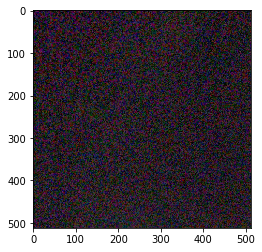

In [78]:
plt.imshow(Image.open(img_path + 'Cover/' + '10254.jpg'))